In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/499B/

/content/drive/MyDrive/499B


In [ ]:
# Importing Packages
import codecs
import os
import re
import time
import gensim
import pandas as pd
import glob
import nltk
import gensim.models.word2vec as w2v
import sklearn.manifold
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
nltk.download('punkt') #installed punkt to fix error
from nltk import word_tokenize
from nltk.corpus import stopwords #Import stopwords to Python
import string #Punctuation
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')

%pylab inline

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
Populating the interactive namespace from numpy and matplotlib


In [ ]:
import re
import pandas as pd
import bs4
import requests
import spacy
from spacy import displacy
nlp = spacy.load('en_core_web_sm')


from spacy.matcher import Matcher 
from spacy.tokens import Span 


import networkx as nx


import matplotlib.pyplot as plt
from tqdm import tqdm


pd.set_option('display.max_colwidth', 200)
%matplotlib inline

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/499B/wiki_sentences_v2.csv')

In [ ]:
df.shape

(4318, 1)

In [ ]:
df[2:7]

,sentence
2,christian is then paralyzed by an elder.
3,the temple is set on fire.
4,"outside, the cult wails with him."
5,it's a parable of a woman's religious awakening—
6,"c. mackenzie, and craig vincent joined the cast."


In [ ]:
stopwords = set(stopwords.words('english')) #English stopwords assigned to "stopwords" object

# Function for removing punctuation
def remove_punctuations(text):
    for punctuation in string.punctuation:
        text = text.replace(punctuation, '')
    return text
    
stopwords = [''.join(item for item in x if item not in string.punctuation) for x in stopwords] #Remove punctuation from stopwords

In [ ]:
df['sentence']=df['sentence'].str.lower()
df[2:7]

,sentence
2,christian is then paralyzed by an elder.
3,the temple is set on fire.
4,"outside, the cult wails with him."
5,it's a parable of a woman's religious awakening—
6,"c. mackenzie, and craig vincent joined the cast."


In [ ]:
df['sentence']=df['sentence'].apply(remove_punctuations)
df[2:7]

,sentence
2,christian is then paralyzed by an elder
3,the temple is set on fire
4,outside the cult wails with him
5,its a parable of a womans religious awakening—
6,c mackenzie and craig vincent joined the cast


In [ ]:
def get_entities(sent):
 ##chunk1
  ent1 = ""
  ent2 = ""


  prv_tok_dep = ""    
  prv_tok_text = ""  


  prefix = ""
  modifier = ""


  
  for tok in nlp(sent):
   
    if tok.dep_ != "punct":
           
      if tok.dep_ == "compound":
        prefix = tok.text
      
        if prv_tok_dep == "compound":
          prefix = prv_tok_text + " "+ tok.text
      
   
      if tok.dep_.endswith("mod") == True:
        modifier = tok.text
       
        if prv_tok_dep == "compound":
          modifier = prv_tok_text + " "+ tok.text
      
    
      if tok.dep_.find("subj") == True:
        ent1 = modifier +" "+ prefix + " "+ tok.text
        prefix = ""
        modifier = ""
        prv_tok_dep = ""
        prv_tok_text = ""      


   
      if tok.dep_.find("obj") == True:
        ent2 = modifier +" "+ prefix +" "+ tok.text
        
  
      prv_tok_dep = tok.dep_
      prv_tok_text = tok.text
 

  return [ent1.strip(), ent2.strip()]

In [ ]:
from tqdm import tqdm
entity_pairs = []


for i in tqdm(df["sentence"]):
  entity_pairs.append(get_entities(i))

100%|██████████| 4318/4318 [00:38<00:00, 111.75it/s]


In [ ]:
entity_pairs[10:20]

[['we', 'tests'],
 ['m global', 'films international sales rights'],
 ['robbie robertson', 'soundtrack'],
 ['it', 'original music tracks'],
 ['it', 'reviewed  franchise'],
 ['she', 'accidentally  mystique'],
 ['', 'military  arrest'],
 ['train', 'vuk'],
 ['telepath', 'gallio'],
 ['singer', 'sequel']]

In [ ]:

def get_relation(sent):


  doc = nlp(sent)


  # Matcher class object 
  matcher = Matcher(nlp.vocab)


  #define the pattern 
  pattern = [{'DEP':'ROOT'}, 
            {'DEP':'prep','OP':"?"},
            {'DEP':'agent','OP':"?"},  
            {'POS':'ADJ','OP':"?"}] 


  matcher.add("matching_1", None, pattern) 


  matches = matcher(doc)
  k = len(matches) - 1


  span = doc[matches[k][1]:matches[k][2]] 


  return(span.text)

In [ ]:
get_relation("Samil finished what he was doing")

'finished'

In [ ]:
relations = [get_relation(i) for i in tqdm(df['sentence'])]

100%|██████████| 4318/4318 [00:36<00:00, 116.88it/s]


In [ ]:
pd.Series(relations).value_counts()[:50]

is               361
was              277
released on       82
are               72
were              69
include           55
released          36
composed by       35
have              31
has               30
became            29
become            28
released in       26
included          25
produced          21
made              20
considered        20
had               19
be                18
called            18
scheduled         17
directed by       16
been              16
written by        16
used              15
hired             14
produced by       14
received          13
stars             13
went              13
introduced in     13
set               12
wanted            11
began in          11
won               11
began             11
wrote             11
sold              10
film              10
gave              10
s                 10
known as          10
gives              9
features           9
shot in            9
going              9
produced in        9
opened       

In [ ]:
# extract subject
source = [i[0] for i in entity_pairs]


# extract object
target = [i[1] for i in entity_pairs]


kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
import networkx as nx
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

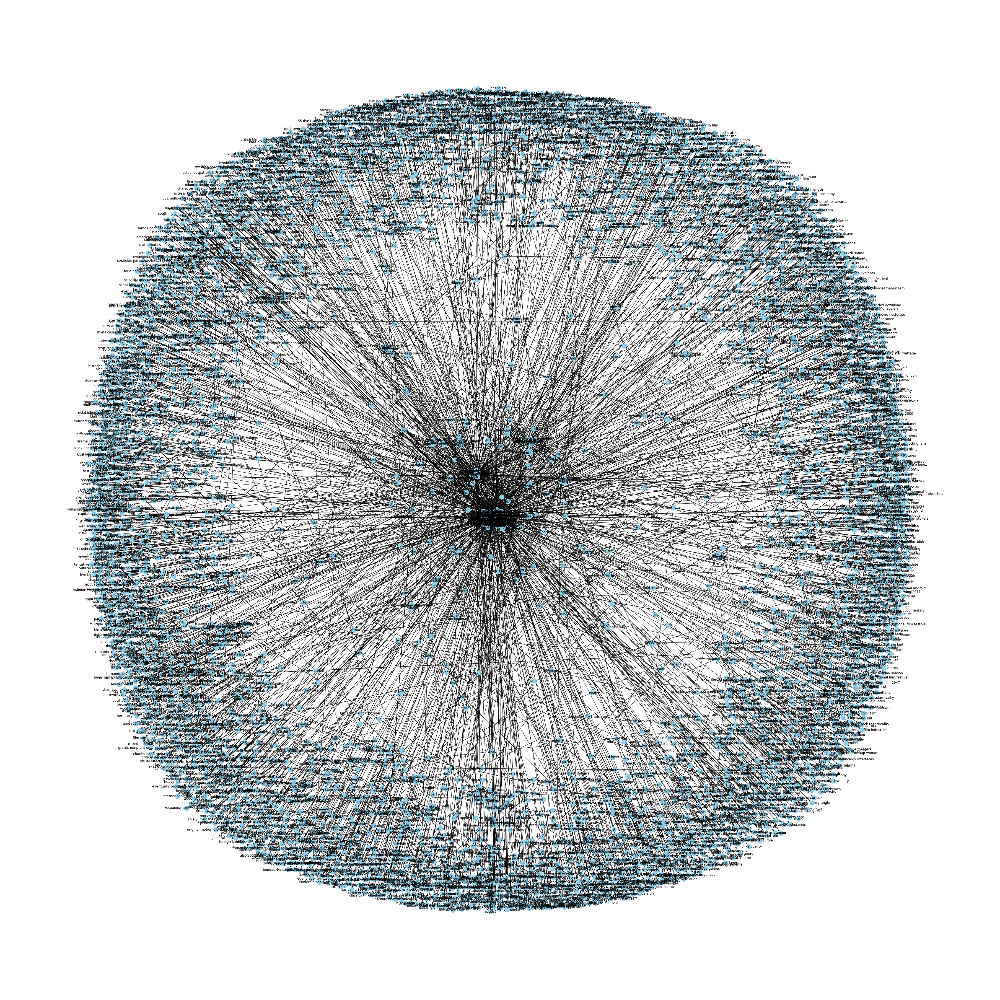

In [ ]:
plt.figure(figsize=(50,50))


pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()


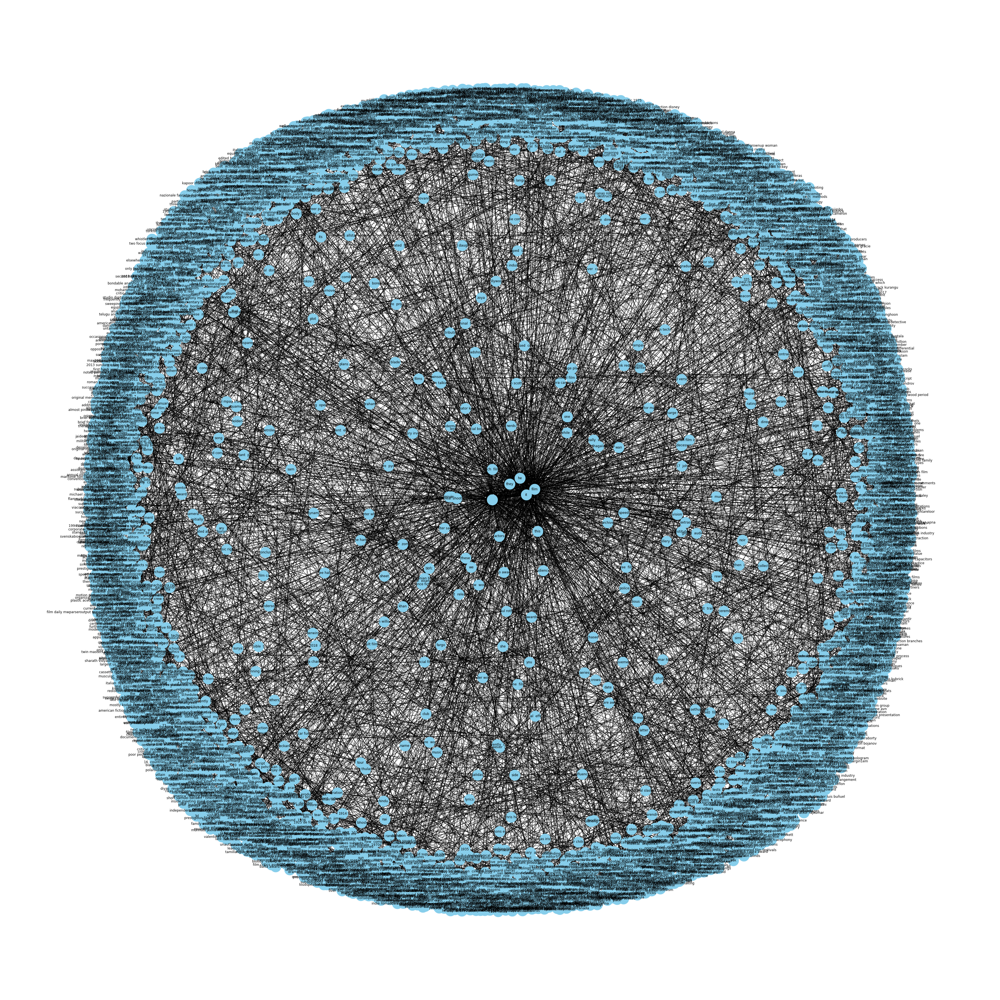

In [ ]:

plt.figure(figsize=(50,50))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

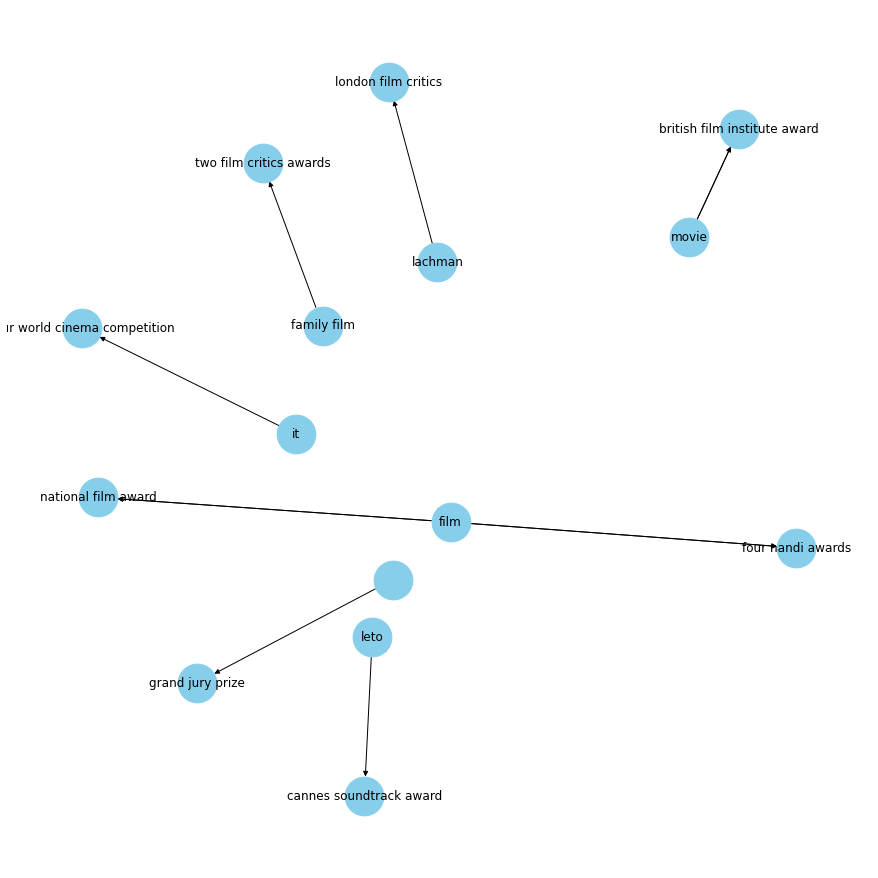

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="won"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()


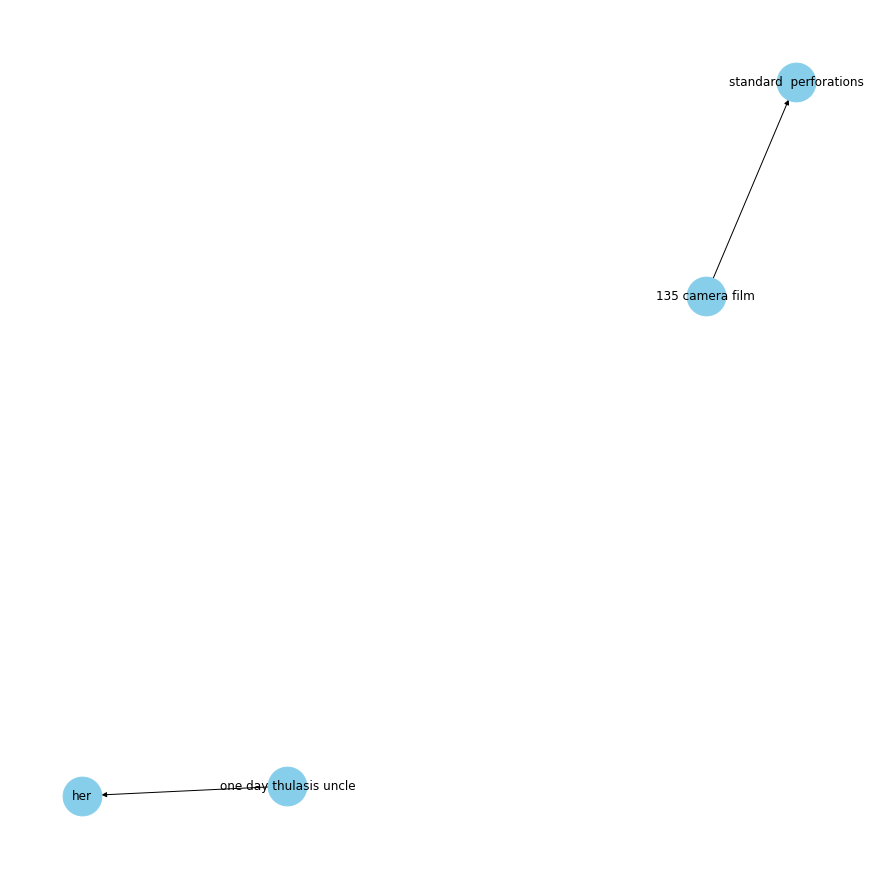

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="comes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

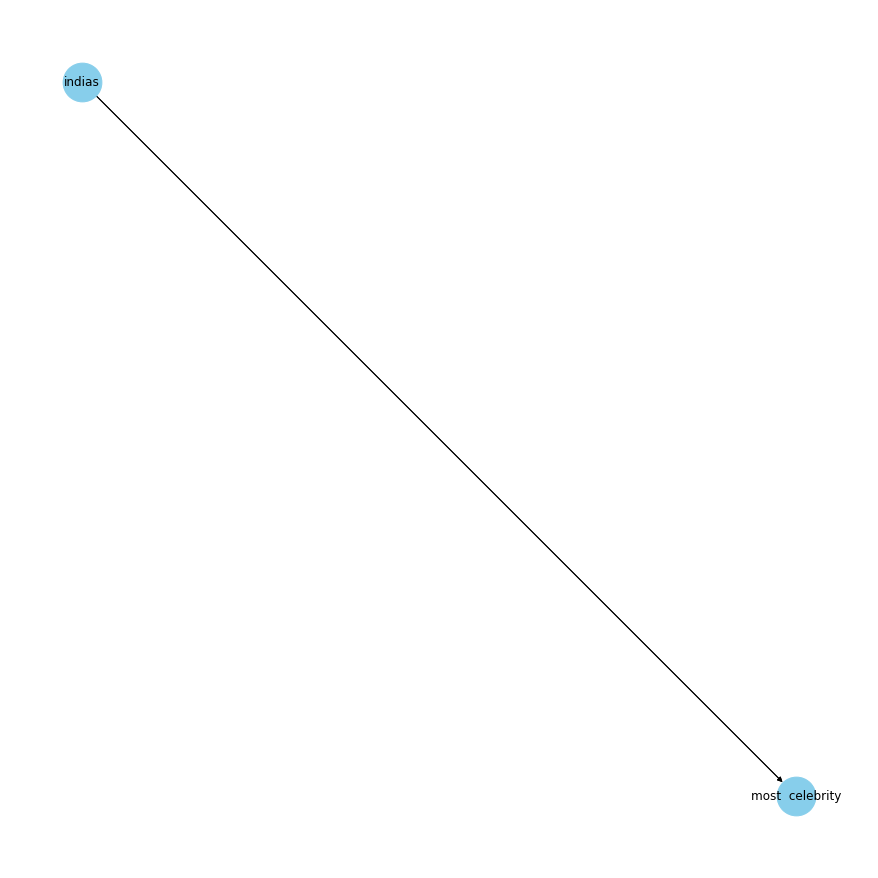

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="declared"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

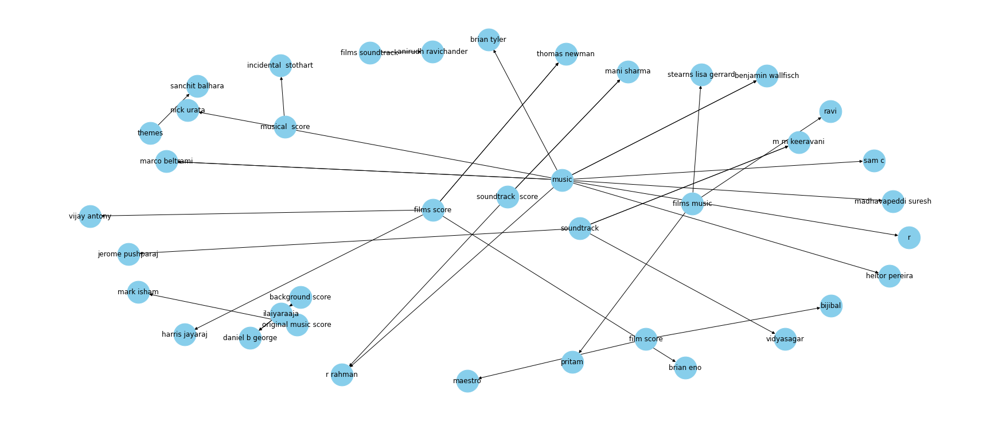

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="composed by"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(24,10))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

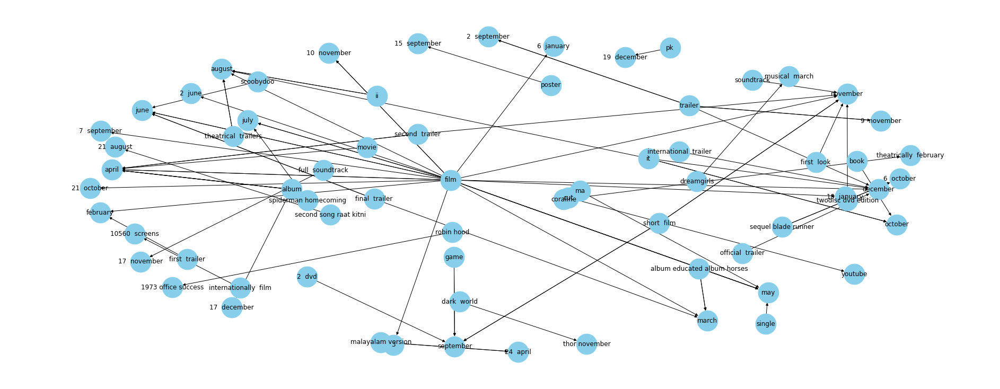

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="released on"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(26,10))
pos = nx.spring_layout(G, k = .5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

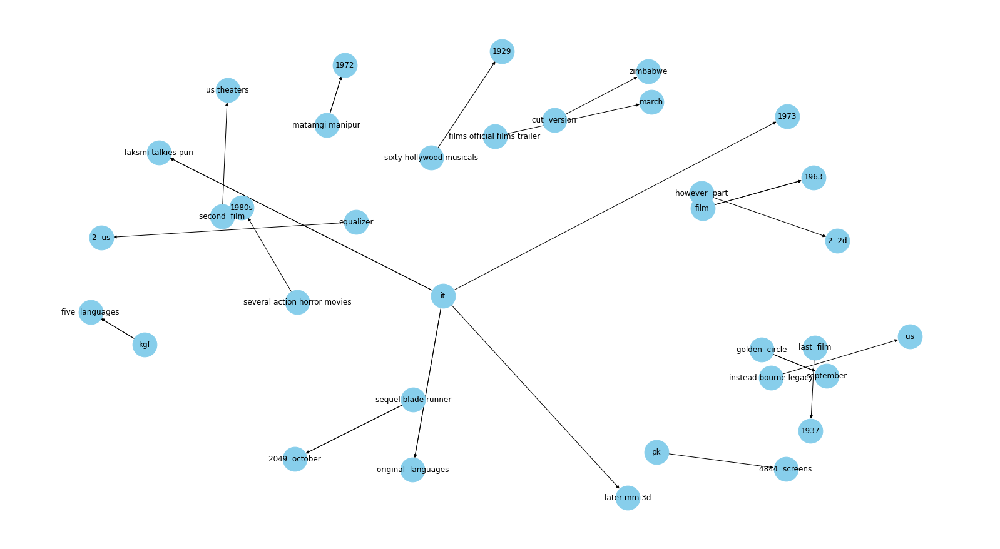

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="released in"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(22,12))
pos = nx.spring_layout(G, k = .5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

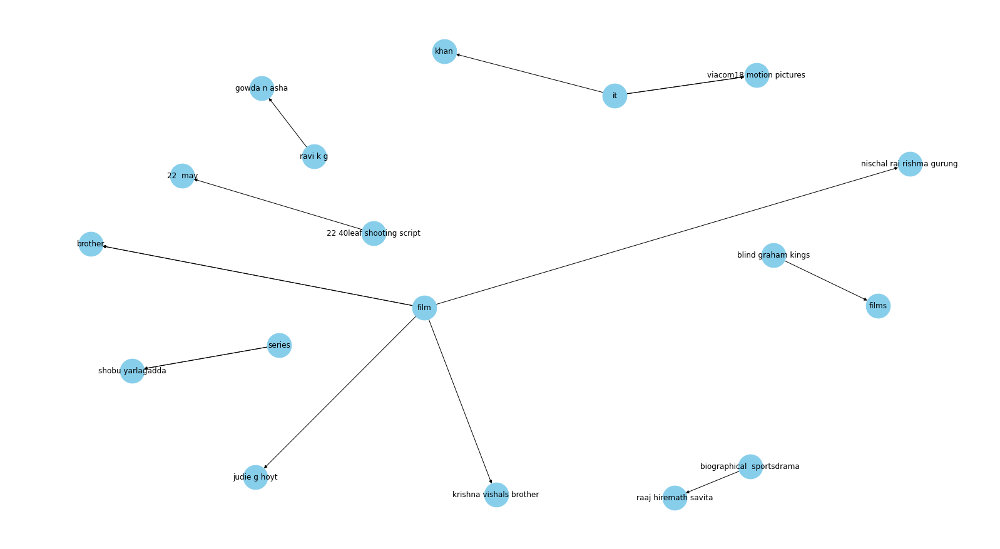

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="produced by"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(22,12))
pos = nx.spring_layout(G, k = .5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

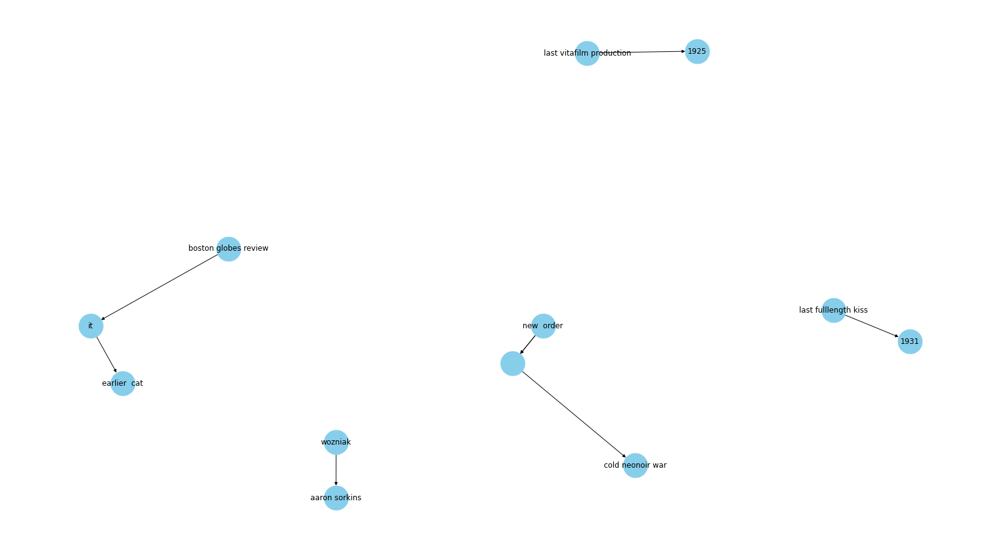

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="film"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(22,12))
pos = nx.spring_layout(G, k = .5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

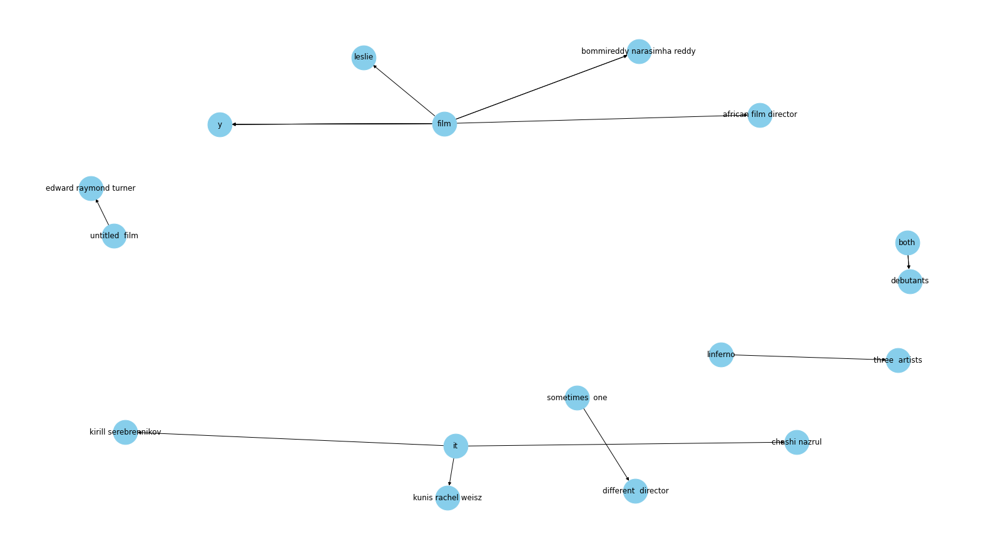

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="directed by"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(22,12))
pos = nx.spring_layout(G, k = .5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

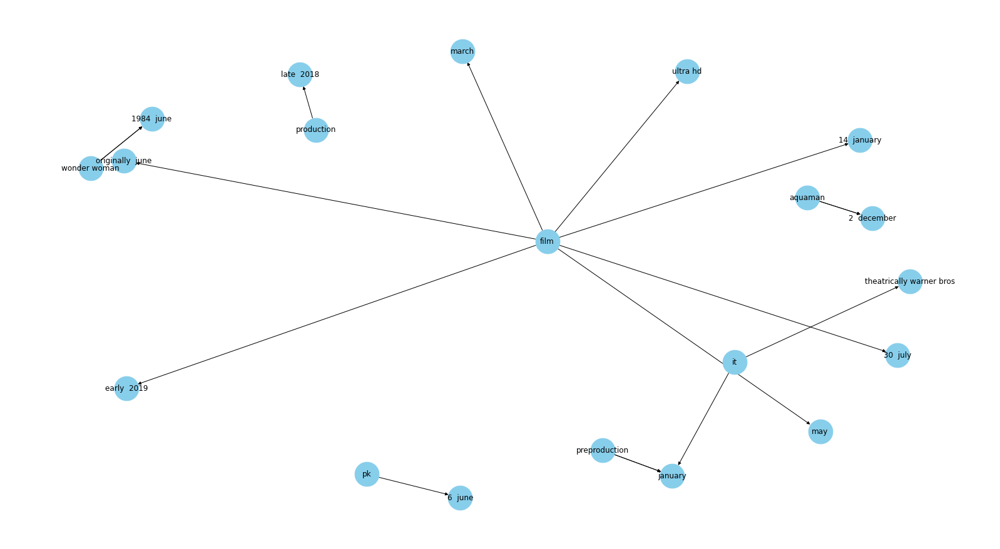

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="scheduled"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(22,12))
pos = nx.spring_layout(G, k = .5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

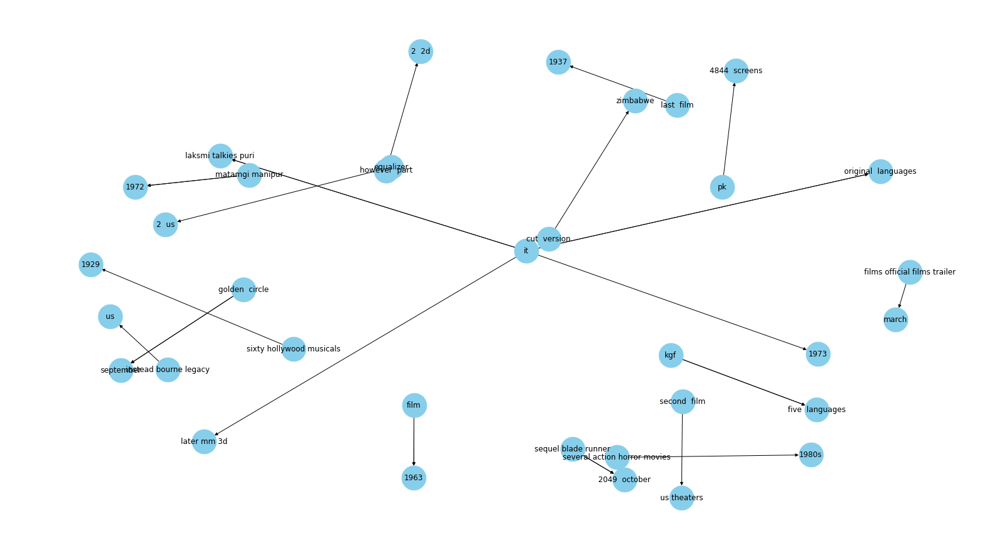

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="released in"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())


plt.figure(figsize=(22,12))
pos = nx.spring_layout(G, k = .5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()